In [ ]:
#Scroll down to saved, harmonized .h5ad, and continue analysis from that point

In [1]:
import scanpy as sc
import anndata as ad
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the AnnData objects
adata_FBN1_mutant_157 = sc.read_10x_mtx('/gpfs/gibbs/pi/dijk/COMMON_DATASETS/tgfbr1r1_and_human_aortic_data/human_aortic_samples/157Cold_vas_HHT/outs/filtered_feature_bc_matrix')
adata_healthy_149 = sc.read_10x_mtx('/gpfs/gibbs/pi/dijk/COMMON_DATASETS/tgfbr1r1_and_human_aortic_data/human_aortic_samples/H149/PR36_OuterMedia_vas_HHT/outs/filtered_feature_bc_matrix')
adata_LDS_162 = sc.read_10x_mtx('/gpfs/gibbs/pi/dijk/COMMON_DATASETS/tgfbr1r1_and_human_aortic_data/human_aortic_samples/H162-vas-cold/outs/filtered_feature_bc_matrix')
adata_Marfan_167 = sc.read_10x_mtx('/gpfs/gibbs/pi/dijk/COMMON_DATASETS/tgfbr1r1_and_human_aortic_data/human_aortic_samples/H167-vas-cold/outs/filtered_feature_bc_matrix')

# Assign patient labels to each AnnData object
adata_FBN1_mutant_157.obs['patient'] = 'FBN1_mutant_157'
adata_healthy_149.obs['patient'] = 'healthy_149'
adata_LDS_162.obs['patient'] = 'LDS_162'
adata_Marfan_167.obs['patient'] = 'Marfan_167'

# List of AnnData objects to concatenate
adata_list = [adata_FBN1_mutant_157, adata_healthy_149, adata_LDS_162, adata_Marfan_167]

# Concatenate the AnnData objects
adata = ad.concat(adata_list, join='outer', merge='unique')

# Verify the pooled AnnData object
print(adata)
print(adata.obs['patient'].value_counts())

# Proceed with further analysis on the pooled object

AnnData object with n_obs × n_vars = 32148 × 36601
    obs: 'patient'
    var: 'gene_ids', 'feature_types'
Marfan_167         21002
FBN1_mutant_157     5796
LDS_162             4258
healthy_149         1092
Name: patient, dtype: int64


/home/pad63/.conda/envs/CellBenderEnv/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [2]:
## Initial Processing with Harmony

In [3]:
sc.pp.filter_cells(adata, min_genes=200) #get rid of cells with fewer than 200 genes
sc.pp.filter_genes(adata, min_cells=3) #get rid of genes that are found in fewer than 3 cells

adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'

In [4]:
#this step is needed later on
sc.pp.calculate_qc_metrics(
    adata, qc_vars=["mt"], percent_top=None, log1p=False, inplace=True
)

In [5]:
#make a copy of the raw_counts as a layer in your adata object in case you need it later on
adata.layers['raw_counts'] = adata.X.copy()

In [6]:
#verify that you see raw counts (integers only) when you run this
print(adata.layers['raw_counts'][1:10])

  (0, 42)	1.0
  (0, 46)	1.0
  (0, 60)	2.0
  (0, 63)	1.0
  (0, 65)	1.0
  (0, 66)	2.0
  (0, 76)	1.0
  (0, 77)	1.0
  (0, 88)	1.0
  (0, 118)	14.0
  (0, 147)	1.0
  (0, 151)	1.0
  (0, 158)	4.0
  (0, 167)	1.0
  (0, 175)	1.0
  (0, 182)	1.0
  (0, 213)	1.0
  (0, 233)	2.0
  (0, 242)	1.0
  (0, 273)	1.0
  (0, 303)	1.0
  (0, 305)	2.0
  (0, 317)	3.0
  (0, 321)	1.0
  (0, 329)	1.0
  :	:
  (8, 24991)	1.0
  (8, 24996)	1.0
  (8, 25012)	1.0
  (8, 25026)	2.0
  (8, 25035)	1.0
  (8, 25062)	2.0
  (8, 25105)	1.0
  (8, 25113)	6.0
  (8, 25121)	1.0
  (8, 25129)	26.0
  (8, 25136)	3.0
  (8, 25157)	1.0
  (8, 25162)	1.0
  (8, 25189)	11.0
  (8, 25190)	5.0
  (8, 25191)	11.0
  (8, 25192)	7.0
  (8, 25194)	6.0
  (8, 25195)	6.0
  (8, 25196)	6.0
  (8, 25197)	1.0
  (8, 25198)	7.0
  (8, 25199)	1.0
  (8, 25200)	2.0
  (8, 25201)	8.0


## Filter out doublets

In [7]:
#make sure you have run pip install scrublet before running this
def doubletFilter(adata):
    import scrublet as scr
    #filtering out doublets for each leiden clustering
    scrub = scr.Scrublet(adata.layers['raw_counts'], expected_doublet_rate = 0.09)
    adata.obs['doublet_scores'], adata.obs['predicted_doublets'] = scrub.scrub_doublets(min_counts=2, min_cells=3, min_gene_variability_pctl=85, n_prin_comps=30)
    adata.obs['predicted_doublets_str'] = adata.obs['predicted_doublets'].astype('str')
    adata.obs['predicted_doublets_v2'] = False
    adata.obs.loc[adata.obs['doublet_scores']>0.23, 'predicted_doublets_v2'] = True #we are using threshold doublet score of 0.23
    num_doublets = sum(adata.obs['predicted_doublets_v2'])
    print(num_doublets/adata.shape[0])
    adata.obs['predicted_doublets_str_v2'] = adata.obs['predicted_doublets_v2'].astype('str')
    adata_no_doub = adata[adata.obs['predicted_doublets_v2']==False].copy()
    return(adata_no_doub)

In [8]:
#make sure you have more than 1 CPUs per task as allocated when you started the jupyter notebook before running this cell
adata_no_doub = doubletFilter(adata)

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.86
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 9.0%
	Estimated  = 33.3%
Elapsed time: 42.0 seconds
0.0329886601480741


/home/pad63/.conda/envs/CellBenderEnv/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


## Continue Pre-Processing

In [9]:
sc.pp.normalize_total(adata_no_doub)

In [10]:
#save a copy of the nromalized data in case you need it later
adata_no_doub.layers['normalized'] = adata_no_doub.X.copy()

In [11]:
sc.pp.log1p(adata_no_doub)
sc.pp.highly_variable_genes(adata_no_doub, flavor='seurat')

In [12]:
adata_no_doub.layers['log1p'] = adata_no_doub.X.copy()

In [13]:
#make sure you have logarithmized data when you run this line of code
print(adata_no_doub.X[1:10])

  (0, 42)	0.26308042
  (0, 46)	0.26308042
  (0, 60)	0.47116712
  (0, 63)	0.26308042
  (0, 65)	0.26308042
  (0, 66)	0.47116712
  (0, 76)	0.26308042
  (0, 77)	0.26308042
  (0, 88)	0.26308042
  (0, 118)	1.6511629
  (0, 147)	0.26308042
  (0, 151)	0.26308042
  (0, 158)	0.7901493
  (0, 167)	0.26308042
  (0, 175)	0.26308042
  (0, 182)	0.26308042
  (0, 213)	0.26308042
  (0, 233)	0.47116712
  (0, 242)	0.26308042
  (0, 273)	0.26308042
  (0, 303)	0.26308042
  (0, 305)	0.47116712
  (0, 317)	0.64332336
  (0, 321)	0.26308042
  (0, 329)	0.26308042
  :	:
  (8, 25057)	0.19798501
  (8, 25062)	0.36317554
  (8, 25075)	0.19798501
  (8, 25113)	0.19798501
  (8, 25116)	0.19798501
  (8, 25121)	0.19798501
  (8, 25128)	0.19798501
  (8, 25129)	2.5681694
  (8, 25140)	0.19798501
  (8, 25149)	0.19798501
  (8, 25157)	0.19798501
  (8, 25189)	1.2884966
  (8, 25190)	1.0121654
  (8, 25191)	2.5848176
  (8, 25192)	2.0239716
  (8, 25193)	0.19798501
  (8, 25194)	2.3002532
  (8, 25195)	2.3432083
  (8, 25196)	1.3471048
  (8, 2

In [14]:
sc.pp.regress_out(adata_no_doub, ["total_counts", "pct_counts_mt"])

In [15]:
#here, you should find values mainly between -1 and 1
print(adata_no_doub.X[1:10])

[[-5.0813297e-04 -5.2210984e-05 -1.5655671e-03 ... -4.9087927e-03
  -3.7833177e-03 -2.4080616e-04]
 [-5.2332028e-04  5.3398139e-06 -1.4760698e-03 ... -3.9636991e-03
  -2.6653667e-03 -4.3171141e-04]
 [-5.1106059e-04 -4.1024472e-05 -1.6448656e-03 ... -4.9108253e-03
  -3.6718817e-03 -3.0280696e-04]
 ...
 [-5.1245524e-04 -3.5701887e-05 -1.6756947e-03 ... -4.8985356e-03
  -3.6113041e-03 -3.3053049e-04]
 [-5.0780876e-04 -5.3238433e-05 -1.7768721e-03 ... -5.3284825e-03
  -4.0328768e-03 -2.9138560e-04]
 [-5.0139794e-04 -7.7804041e-05 -1.5310086e-03 ... -5.1862481e-03
  -4.1990629e-03 -1.3676684e-04]]


In [16]:
sc.pp.scale(adata_no_doub, max_value=10)

## Application of Harmony and Clustering

In [17]:
pip install harmonypy

Note: you may need to restart the kernel to use updated packages.


In [18]:
pip install harmony-pytorch

Note: you may need to restart the kernel to use updated packages.


In [19]:
from harmony import harmonize

import numpy as np

In [21]:
sc.tl.pca(adata_no_doub)

adata_no_doub.obsm['X_harmony'] = harmonize(np.array(adata_no_doub.obsm['X_pca']), adata_no_doub.obs, batch_key = ['patient'])
sc.pp.neighbors(adata_no_doub, use_rep='X_harmony', n_neighbors=10, n_pcs=40)

	Initialization is completed.
	Completed 1 / 10 iteration(s).
	Completed 2 / 10 iteration(s).
	Completed 3 / 10 iteration(s).
	Completed 4 / 10 iteration(s).
	Completed 5 / 10 iteration(s).
Reach convergence after 5 iteration(s).


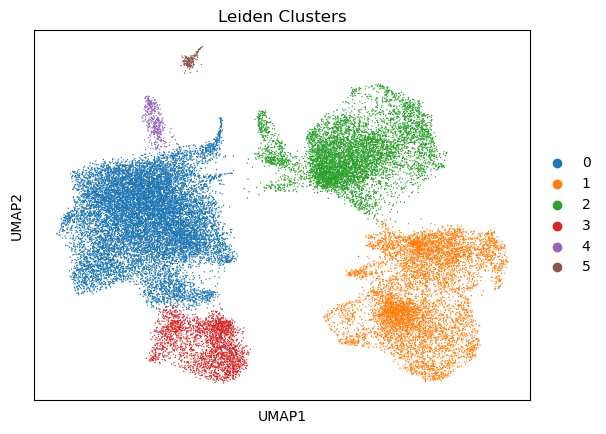

In [22]:
sc.tl.umap(adata_no_doub)
#choose resolution for leiden clustering. Remember -- the resolution is directly proportional to the number of cell clusters you want to end up with.
sc.tl.leiden(adata_no_doub, resolution=0.1)
sc.pl.umap(adata_no_doub, color=['leiden'], vmax='p95', title='Leiden Clusters') 

In [33]:
#Save this Adata object so we dont have to wait this long for harmony again (then we can just run from here down)

In [34]:
# Save the AnnData object to a file
adata_no_doub.write('/gpfs/gibbs/project/chung/shared/notebooks/DVD_aorta_analysis/adata_no_doub_post_harmony_7_29_2024.h5ad')

## Determine which cell cluster is which

In [114]:
#Fill in this dictionary with whatever genes you want.  Feel free to remove things from this list if they are not useful to you.
#Moreover, this list is not an exhaustive list of marker genes for any given cell type.

marker_genes = {
    "Smooth Muscle": ['MYH11', 'TAGLN'],
    "Endothelial Cells": ['FLT1', 'PECAM1'],
   # "Immune Cells": ['PTPRC'],
    #"B Cells": ['MS4A7'],
    "Fibroblasts": ['DCN', 'LUM', 'PDGFRA', 'CFD', 'APOD'],
    "Neural Cells": ['GPM6B'],
    #"Neutrophils": ['CSF3R'],
    "Macrophages": ['CD14'],
    "T-NK": ['NCAM1', 'KLRD1'],
    "Helper T": ['CD4'], 
    "Dendritic": ['CD83'],
    "Myeloid derived suppressor cells": ["CD14"],
    "Lymphatic Endothelial Cells": ['PROX1', 'FLT4'],
    "Vascular Endothelial Cells": ['VWF'],
    "Potential Endothelial Subpopulation": ['NRP2', 'COL15A1', 'PCDH17', 'ITGA6'],
    "Pericyte": ["ABCC9"],
    "Chondrocytes": ["RUNX2","COL15A1"],
    "adipocyte_markers": ["PPARG","LPL","ADIPOQ","FABP4","UCP1"],
    "Genes of Interest": ["KLF4",'DCN', 'LUM', 'PDGFRA', 'CFD', 'APOD', 'ABCA1','ABCG1']
}

In [36]:
#save all figures to this directory
sc.settings.figdir = "/Path/to/your/desired/figures/directory"

In [37]:
genes_list = [
    "ACTA2",
    "TAGLN",
    "MYH11",
    "LGALS3",
    "CD68",
    "CD34",
    "COL1A1",
    "S100β",
    "OCT4",
    "SOX9",
    "RUNX2",
    "ALP",
    "OPN",
    "BMP2",
    "H3K4me2",
    "MMP-2",
    "MMP-9",
    "PDGF-BB",
    "TNF-α",
    "IFN-γ",
    "IL-1",
    "ApoB",
    "HSPG",
    "VWF",
    "FABP4",
    "SMAD2",
    "SMAD3",
    "MYF5",
    "α7β1 Integrin",
    "α8β1 Integrin",
    "α9β1 Integrin",
    "miR-206",
    "miR-34a",
    "miR-542-3p",
    "miR-135a",
    "miR-223-3p",
    "miR-143",
    "miR-145",
    "SIRT1",
    "SIRT6",
    "Gli1",
    "CD137",
    "NFATc1",
    "COL2A1",
    "COL10A1",
    "ANXA2",
    "NLRP3",
    "AXL",
    "ARF6",
    "NCX1",
    "KLF4",
    "STAT3",
    "Poly(ADP-ribose) polymerase 1",
    "CD40",
    "LIGHT",
    "OX40",
    "CD34"
]

In [38]:
genes_present = adata_no_doub.var.index.unique().tolist()

In [39]:
cool_genes = []
for value in genes_list:
    if value in genes_present:
        cool_genes.append(value)

Smooth Muscle Markers


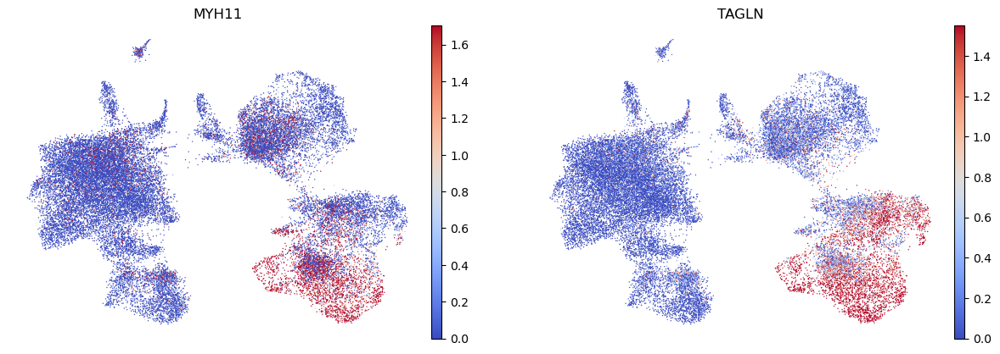





Endothelial Cells Markers


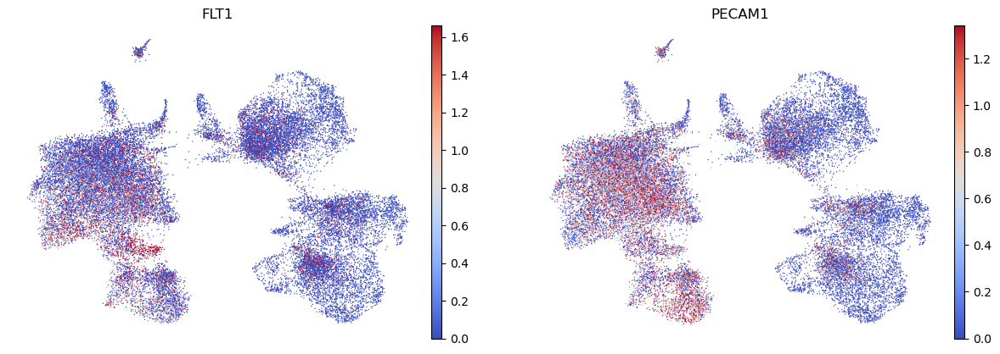





Fibroblasts Markers


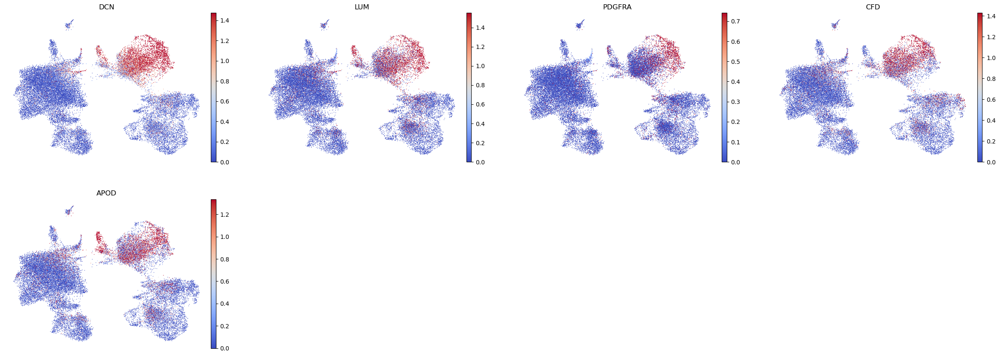





Neural Cells Markers


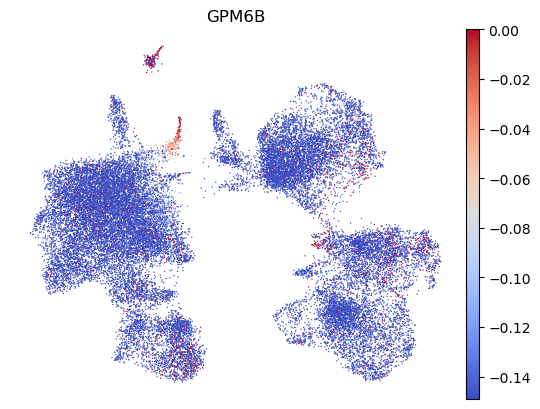





Macrophages Markers


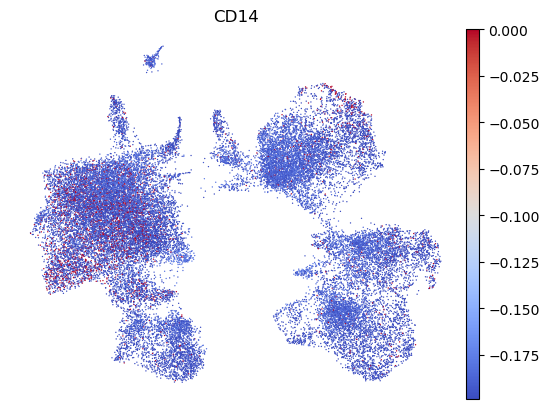





T-NK Markers


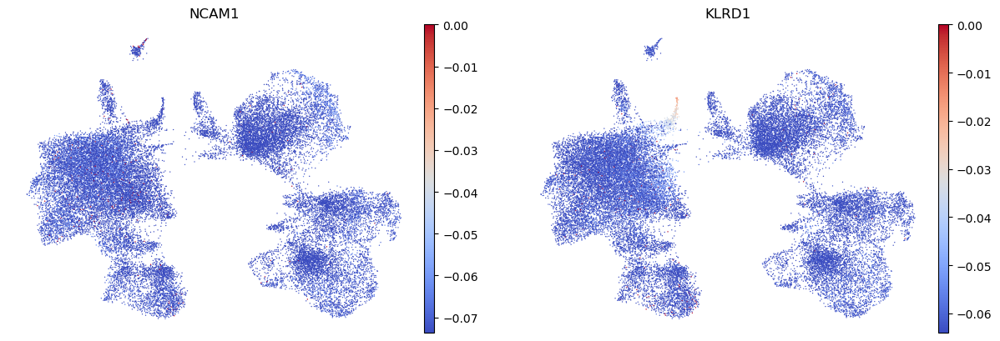





Helper T Markers


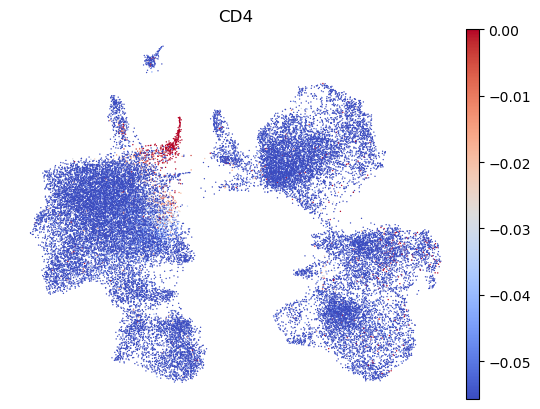





Dendritic Markers


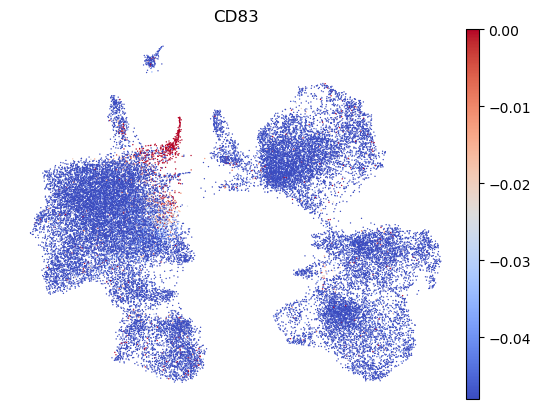





Myeloid derived suppressor cells Markers


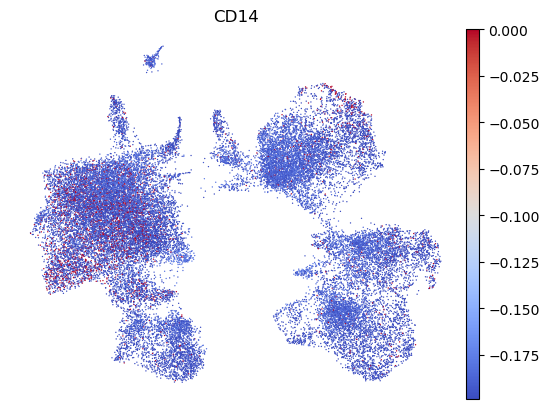





Lymphatic Endothelial Cells Markers


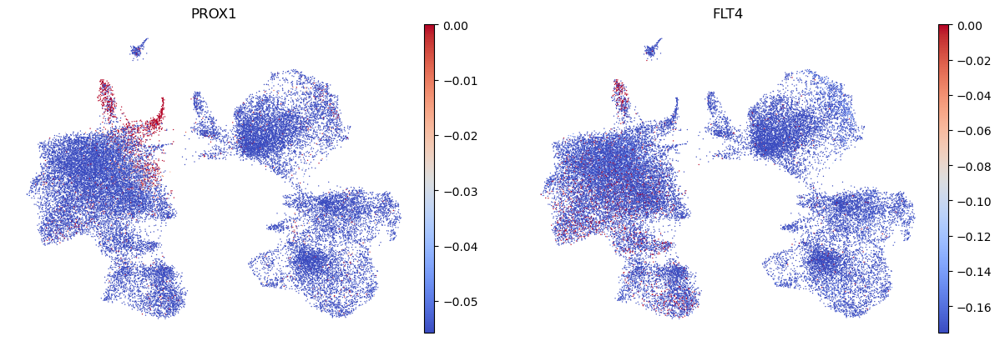





Vascular Endothelial Cells Markers


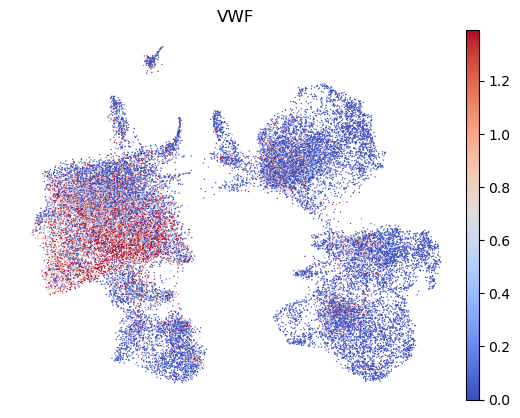





Potential Endothelial Subpopulation Markers


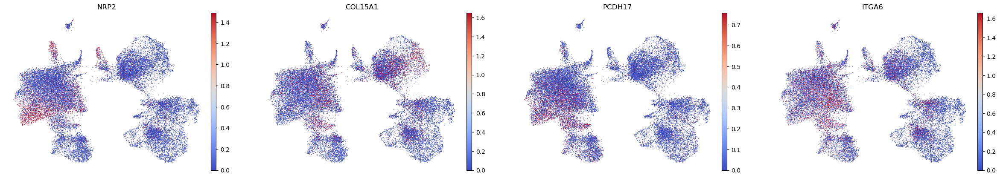





Pericyte Markers


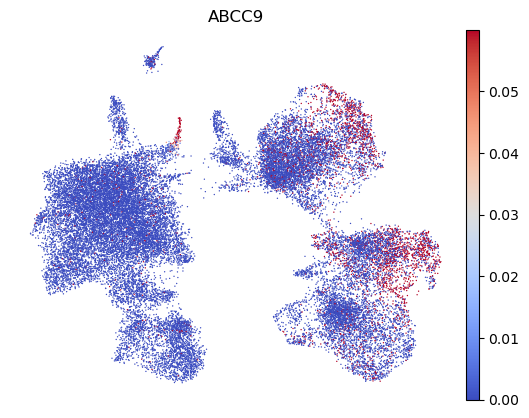





Chondrocytes Markers


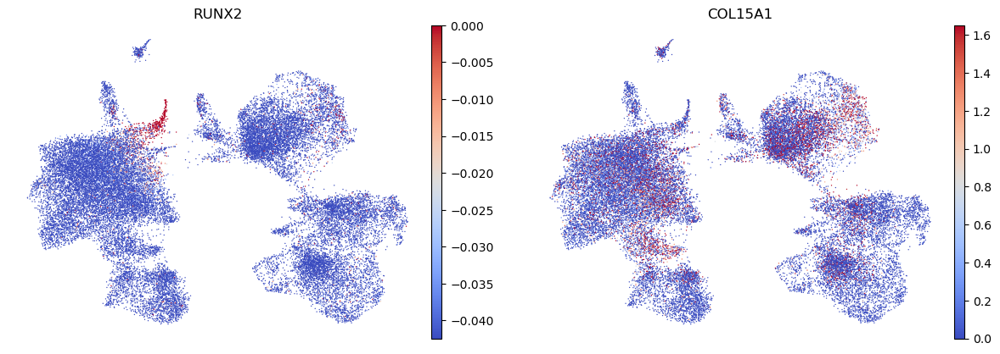





adipocyte_markers Markers


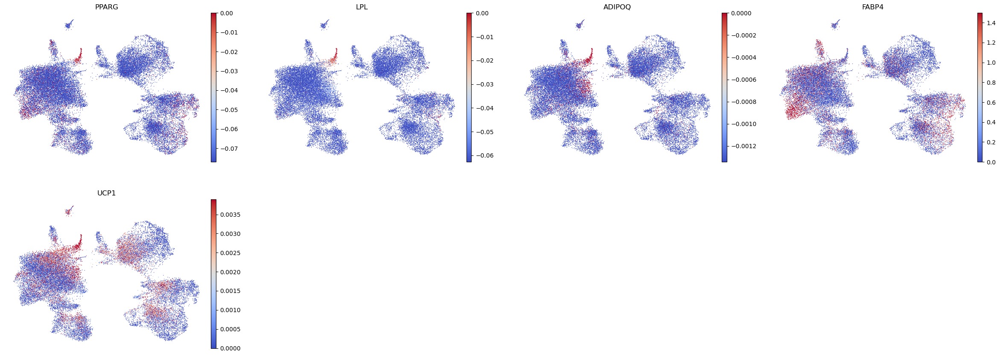





Genes of Interest Markers


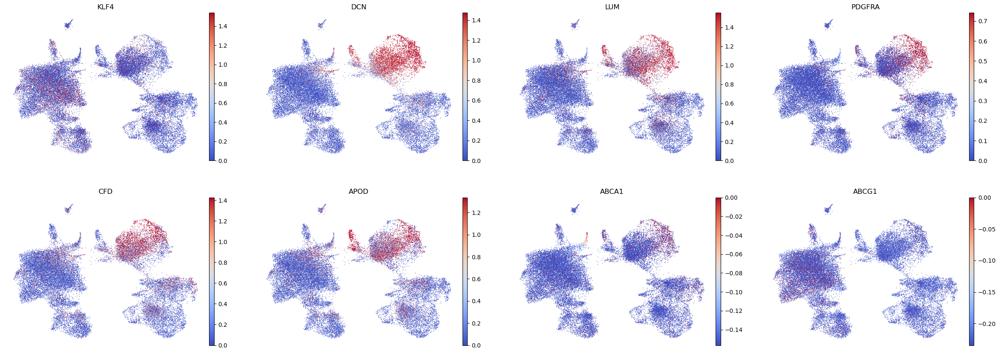

In [115]:
for key in marker_genes.keys():

    print("{} Markers".format(key))
    sc.pl.umap(
        adata_no_doub,
        color=marker_genes["{}".format(key)],
        vmin=0,
        vmax="p90",  # set vmax to the 90th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="coolwarm",
    )
    print("\n\n\n")  # print white space for legibility

In [41]:
mesenchymal_marker_genes = {"Mesenchymal": ["KLF4","SP1"]}

Mesenchymal Markers


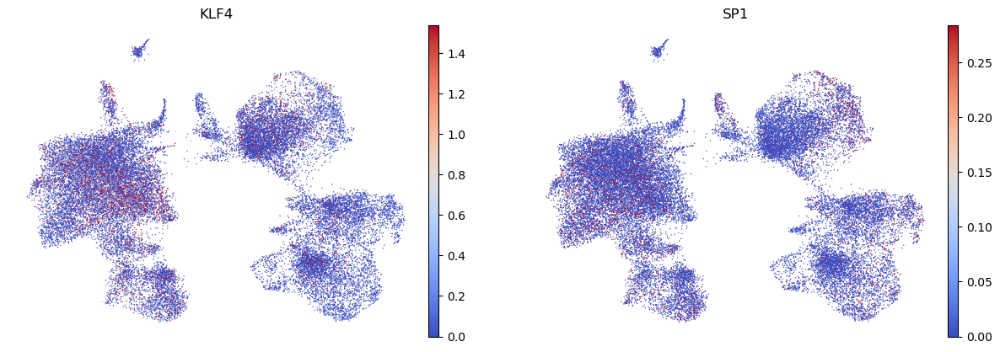

In [42]:
for key in mesenchymal_marker_genes.keys():
    print("{} Markers".format(key))
    sc.pl.umap(
        adata_no_doub,
        color=mesenchymal_marker_genes["{}".format(key)],
        vmin=0,
        vmax="p90",  # set vmax to the 90th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
        sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
        frameon=False,
        cmap="coolwarm",
    )
    print("\n\n\n")  # print white space for legibility

In [43]:
adipocyte_markers = ["PPARG","LPL","ADIPOQ","FABP4","UCP1"]

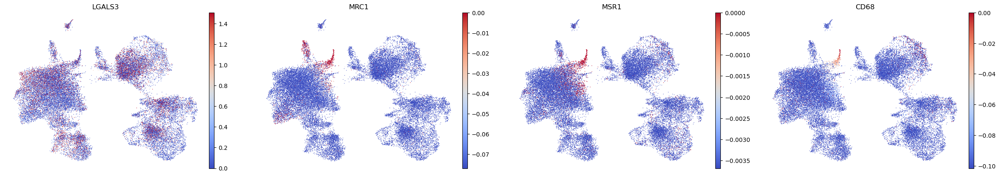

In [44]:
##This is LGALS3 vs. conventional macrophage markers
genes_from_BMC = ["LGALS3",'MRC1','MSR1','CD68']
sc.pl.umap(
    adata_no_doub,
    color=genes_from_BMC,
    vmin=0,
    vmax="p90",  # set vmax to the 90th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
    sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
    frameon=False,
    cmap="coolwarm",
)

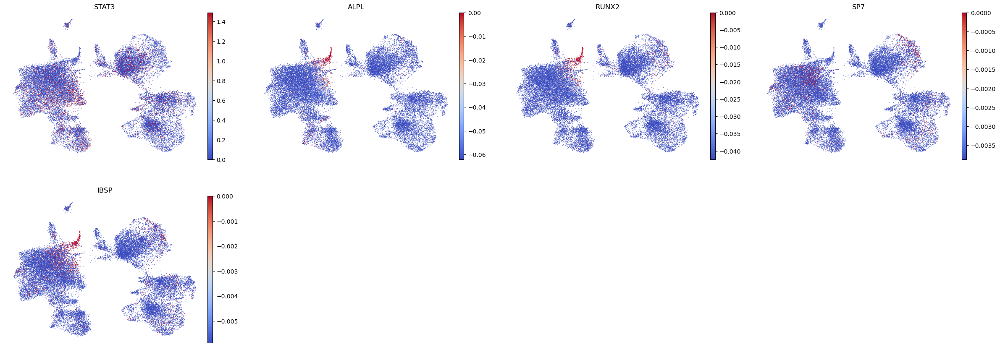

In [45]:
##This is STAT3 vs. conventional osteoblast markers
genes_from_BMC = ["STAT3","ALPL","RUNX2","SP7","IBSP"]
sc.pl.umap(
    adata_no_doub,
    color=genes_from_BMC,
    vmin=0,
    vmax="p90",  # set vmax to the 90th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
    sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
    frameon=False,
    cmap="coolwarm",
)

         Falling back to preprocessing with `sc.pp.pca` and default params.


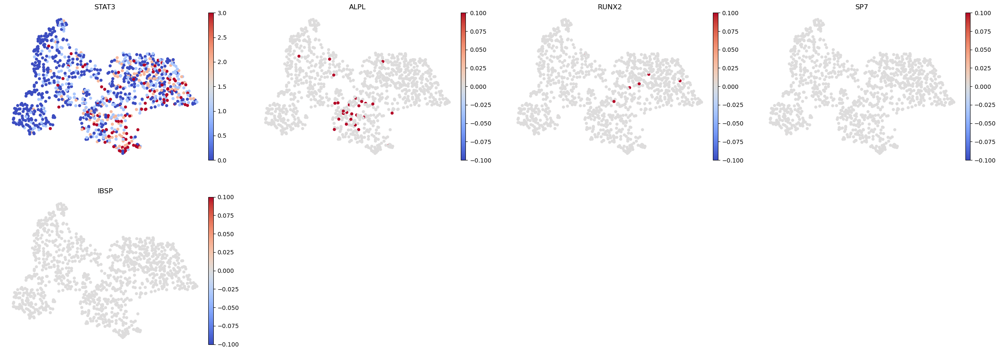

In [46]:
sc.pp.neighbors(adata_healthy_149,n_neighbors=10)
sc.tl.umap(adata_healthy_149)
sc.pl.umap(
    adata_healthy_149,
    color=genes_from_BMC,
    vmin=0,
    vmax="p90",  # set vmax to the 90th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
    sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
    frameon=False,
    cmap="coolwarm",
)

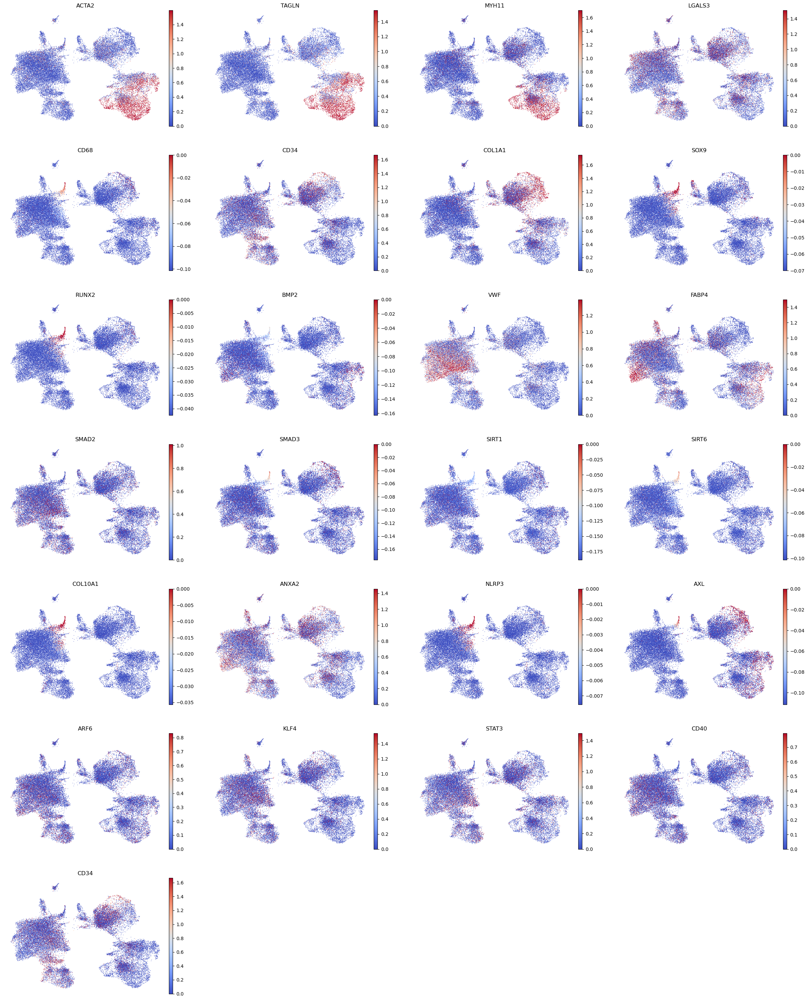

In [47]:
sc.pl.umap(
    adata_no_doub,
    color=cool_genes,
    vmin=0,
    vmax="p90",  # set vmax to the 90th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
    sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
    frameon=False,
    cmap="coolwarm",
)

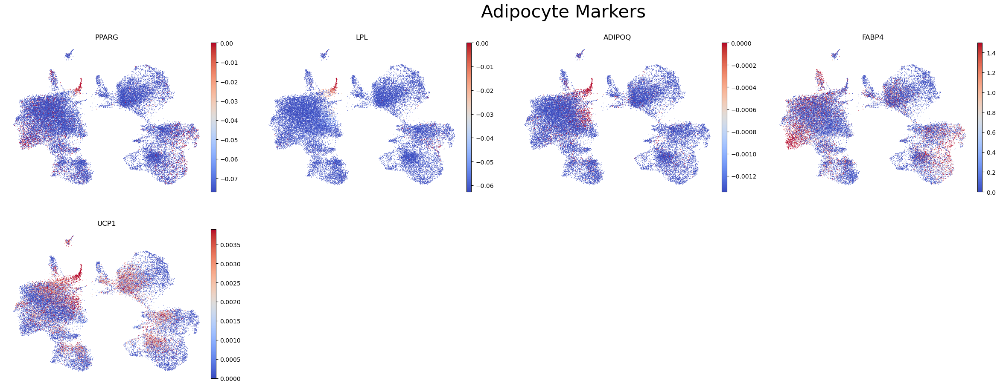

In [48]:
import matplotlib.pyplot as plt
sc.pl.umap(
    adata_no_doub,
    color=adipocyte_markers,
    vmin=0,
    vmax="p90",
    sort_order=False,
    frameon=False,
    cmap="coolwarm",
    show=False  # Disable auto-showing to control when the plot is displayed
)
# Add a supratitle
plt.suptitle("Adipocyte Markers", fontsize=30)

# Display the plot
plt.show()

categories: 0, 1, 2, etc.
var_group_labels: Smooth Muscle, Endothelial Cells, Fibroblasts, etc.


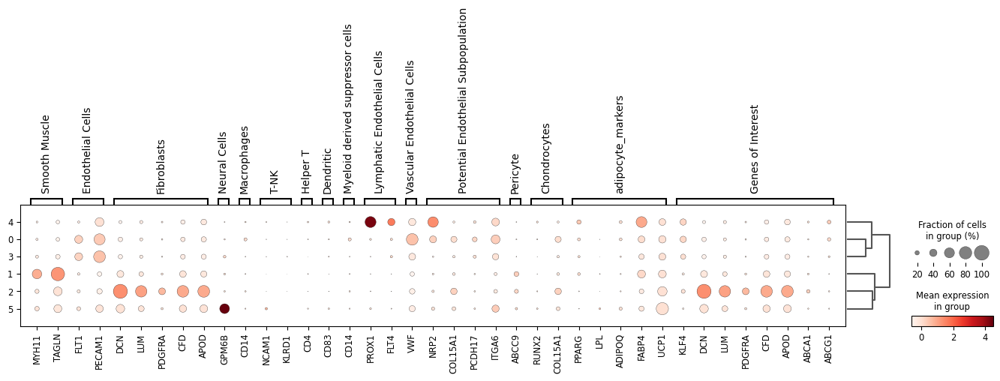

In [116]:
# you can also run a dotplot

sc.tl.dendrogram(adata_no_doub, groupby='leiden')
sc.pl.dotplot(adata_no_doub, marker_genes, groupby='leiden', dendrogram=True)

                   leiden                    cell_type
AAACCCACAGGTCCCA-1      3                  Endothelial
AAACCCAGTGAGAACC-1      0  Vascular Endothelial by VWF
AAACCCATCGCGCTGA-1      3                  Endothelial
AAACGAAAGCAATAGT-1      0  Vascular Endothelial by VWF
AAACGAAAGCGAACTG-1      0  Vascular Endothelial by VWF


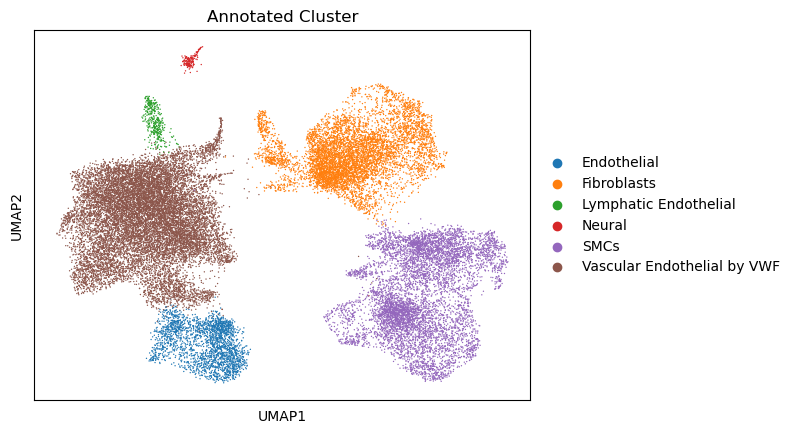

In [50]:
import pandas as pd

# Define the mapping from leiden values to cell types
leiden_to_cell_type = {
    '0': 'Vascular Endothelial by VWF',
    '1': 'SMCs',
    '2': 'Fibroblasts',
    '3': 'Endothelial',
    '4': 'Lymphatic Endothelial',
    '5': 'Neural'
}

# Ensure the leiden column is in string format
adata_no_doub.obs['leiden'] = adata_no_doub.obs['leiden'].astype(str)

# Create the new cell_type column by mapping leiden values to cell types
adata_no_doub.obs['cell_type'] = adata_no_doub.obs['leiden'].map(leiden_to_cell_type)

# Check the first few rows to ensure the mapping is correct
print(adata_no_doub.obs[['leiden', 'cell_type']].head())
sc.pl.umap(adata_no_doub, color=['cell_type'], vmax='p95', title='Annotated Cluster') 

In [51]:
# Count the number of cells classified as 'SMCs'
num_SMCs = (adata_no_doub.obs['cell_type'] == 'SMCs').sum()

# Count the total number of cells
total_cells = adata_no_doub.shape[0]

# Print the results
print(f"Number of SMCs cells: {num_SMCs}")
print(f"Total number of cells: {total_cells}")
print(f"Proportion of SMCs cells: {num_SMCs / total_cells:.2%}")

Number of SMCs cells: 7016
Total number of cells: 30955
Proportion of SMCs cells: 22.67%


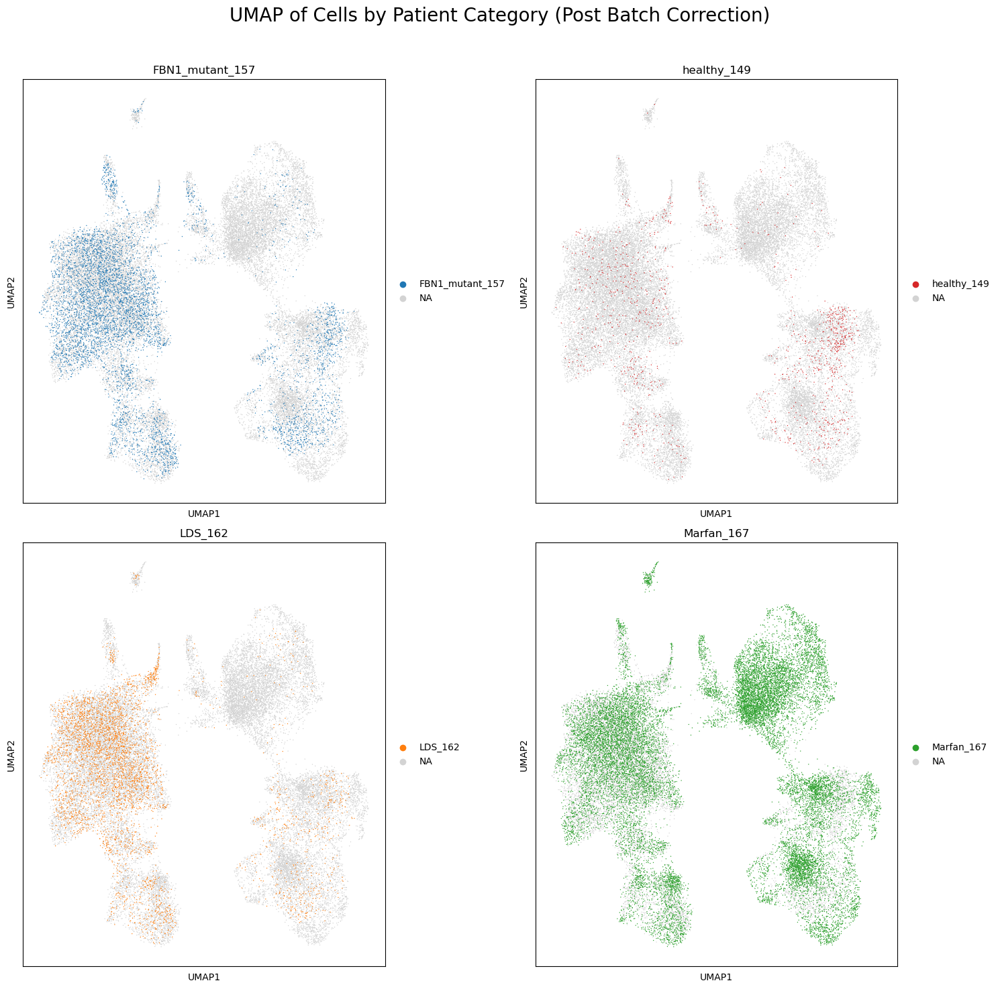

In [52]:
patients = ['FBN1_mutant_157', 'healthy_149', 'LDS_162', 'Marfan_167']

# Create a figure with 2x2 subplots
fig, axes = plt.subplots(2, 2, figsize=(15, 15))

# Flatten axes for easy iteration
axes = axes.flatten()

# Create a UMAP plot for each patient category
for i, patient in enumerate(patients):
    sc.pl.umap(adata_no_doub, color='patient', groups=[patient], ax=axes[i], show=False)
    axes[i].set_title(patient)

# Set the main title for the entire figure
fig.suptitle('UMAP of Cells by Patient Category (Post Batch Correction)', fontsize=20)

# Adjust layout to make room for the main title
plt.tight_layout(rect=[0, 0, 1, 0.96])

In [53]:
adata_no_doub_SMCs = adata_no_doub[adata_no_doub.obs['cell_type'] == 'SMCs']

In [54]:
import phate

In [55]:
##DPT Computation

In [56]:
# Clear any existing root cell index
if 'iroot' in adata_no_doub.uns:
    del adata_no_doub.uns['iroot']

In [57]:
# Step 1: Compute Diffusion Maps
sc.pp.neighbors(adata_no_doub, n_neighbors=30, use_rep='X_pca')
sc.tl.diffmap(adata_no_doub, n_comps=15)

In [58]:
# Example: Select the cell with the lowest PCA component as the root cell
root_cell_index = adata_no_doub.obsm['X_harmony'][:, 0].argmin()  # Replace with appropriate criteria
adata_no_doub.uns['iroot'] = root_cell_index

In [59]:
# Calculate Diffusion Pseudotime
sc.tl.dpt(adata_no_doub, n_dcs=10)  # Use appropriate number of diffusion components

In [ ]:
##I believe this is the proper PHATE calculation

In [88]:
phate_operator = phate.PHATE()
adata_no_doub.obsm['X_harmony'] = phate_operator.fit_transform(adata_no_doub.X)

Calculating PHATE...
  Running PHATE on 30955 observations and 25212 variables.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 19.72 seconds.
    Calculating KNN search...
    Calculated KNN search in 245.81 seconds.
    Calculating affinities...
    Calculated affinities in 92.17 seconds.
  Calculated graph and diffusion operator in 357.79 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 13.16 seconds.
    Calculating KMeans...
    Calculated KMeans in 5.86 seconds.
  Calculated landmark operator in 20.30 seconds.
  Calculating optimal t...
    Automatically selected t = 34
  Calculated optimal t in 2.77 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 0.31 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 4.91 seconds.
Calculated PHATE in 386.10 seconds.


<Figure size 1000x800 with 0 Axes>

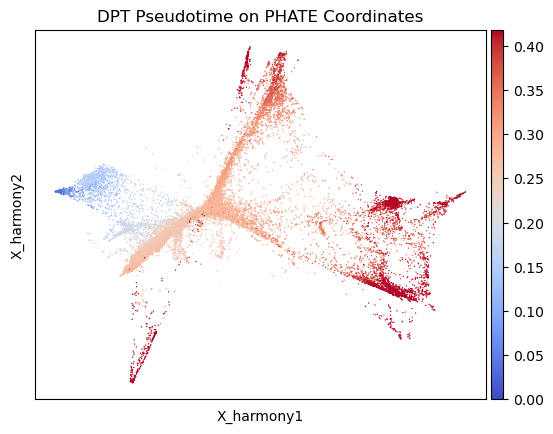

In [89]:
plt.figure(figsize=(10, 8))
sc.pl.embedding(adata_no_doub, basis='X_harmony', color='dpt_pseudotime', cmap='coolwarm', show=False, vmax = 'p95')
plt.title("DPT Pseudotime on PHATE Coordinates")
plt.show()

##Subsection my adata_no_doub object into two new objects. One that contains all cells for which the cell_type is 'SMCs'. And one for all cells for which cell_type is 'Vascular Endothelial by VWF'

In [90]:
# Ensure the 'cell_type' column exists in adata_no_doub
if 'cell_type' in adata_no_doub.obs.columns:
    # Subset the AnnData object for cells labeled as 'SMCs'
    adata_SMCs = adata_no_doub[adata_no_doub.obs['cell_type'] == 'SMCs'].copy()
    
    # Subset the AnnData object for cells labeled as 'Vascular Endothelial by VWF'
    adata_vascular_endothelial = adata_no_doub[adata_no_doub.obs['cell_type'] == 'Vascular Endothelial by VWF'].copy()

/home/pad63/.conda/envs/CellBenderEnv/lib/python3.7/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


<Figure size 1000x800 with 0 Axes>

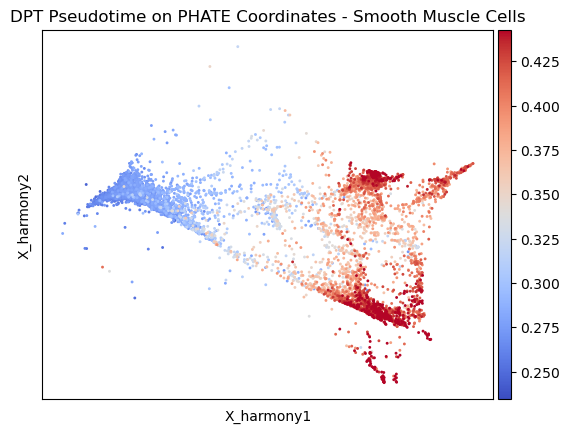

In [91]:
plt.figure(figsize=(10, 8))
sc.pl.embedding(adata_SMCs, basis='X_harmony', color='dpt_pseudotime', cmap='coolwarm', show=False, vmax = 'p95')
plt.title("DPT Pseudotime on PHATE Coordinates - Smooth Muscle Cells")
plt.show()

<Figure size 1000x800 with 0 Axes>

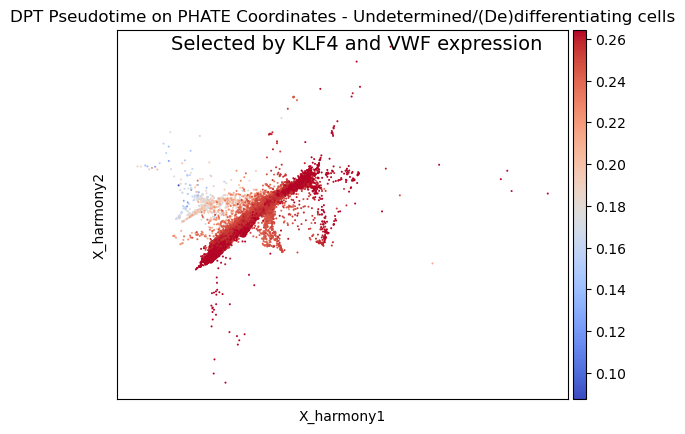

In [93]:
plt.figure(figsize=(10, 8))
sc.pl.embedding(adata_vascular_endothelial, basis='X_harmony', color='dpt_pseudotime', cmap='coolwarm', show=False, vmax = 'p95')
plt.title("DPT Pseudotime on PHATE Coordinates - Undetermined/(De)differentiating cells")
plt.suptitle("Selected by KLF4 and VWF expression", y=0.87, fontsize=14)
plt.show()

In [94]:
sc.tl.score_genes(adata_SMCs, ['MYOCD','MYH11','TAGLN','ACTA2','SMTN','CNN1'], score_name='VSMC_contractile_2')
sc.tl.score_genes(adata_SMCs, ['KLF4','CD34','CD44'], score_name='VSMC_mesenchymal_2')
sc.tl.score_genes(adata_SMCs, ['FN1','BGN','DCN','COL1A1'], score_name='VSMC_fibroblast_2')
sc.tl.score_genes(adata_SMCs, ['PTPRC','CD68','ITGAM','LGALS3','ADGRE1'], score_name='VSMC_macrophage_2')
sc.tl.score_genes(adata_SMCs, ['SP7',"SOX9","MSX2",'RUNX2'], score_name='VSMC_osteogenic_2')
sc.tl.score_genes(adata_SMCs, ['UCP1','ELOVL3','ADIPOQ','PRDM16','PPARGC1A'], score_name='VSMC_adipocyte_2')
sc.tl.score_genes(adata_SMCs, ['VWF','PROX1', 'FLT4','NRP2', 'COL15A1', 'PCDH17', 'ITGA6'], score_name='VSMC_endothelial_2')

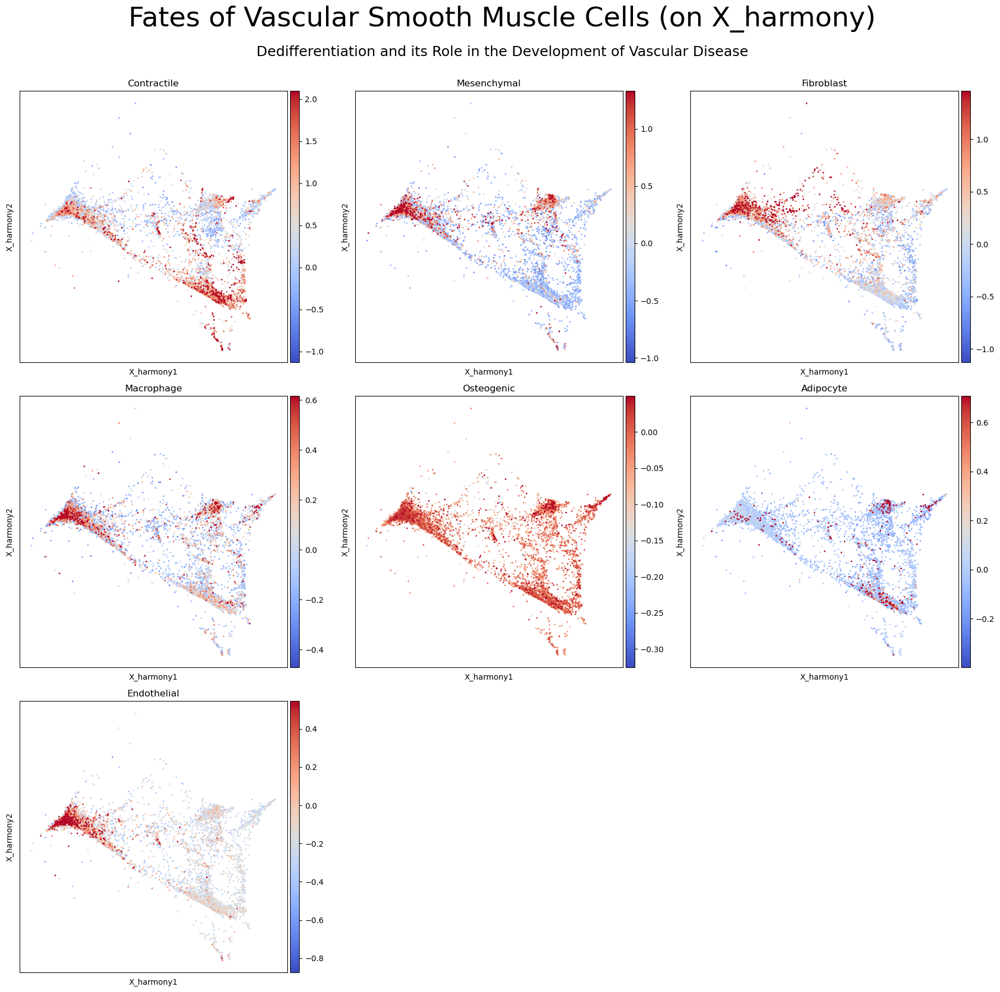

In [105]:
# Create a 3x3 grid for 7 plots
fig, axs = plt.subplots(3, 3, figsize=(18, 18))
fig.suptitle("Fates of Vascular Smooth Muscle Cells (on X_harmony)", fontsize=35)
plt.subplots_adjust(top=0.92)  # Adjust top to fit the subtitle
fig.text(0.5, 0.93, "Dedifferentiation and its Role in the Development of Vascular Disease", ha='center', fontsize=18)

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_contractile_2', cmap='coolwarm', vmax="p97", ax=axs[0, 0], show=False)
axs[0, 0].set_title("Contractile")

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_mesenchymal_2', cmap='coolwarm', vmax="p97", ax=axs[0, 1], show=False)
axs[0, 1].set_title("Mesenchymal")

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_fibroblast_2', cmap='coolwarm', vmax="p97", ax=axs[0, 2], show=False)
axs[0, 2].set_title("Fibroblast")

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_macrophage_2', cmap='coolwarm', vmax="p97", ax=axs[1, 0], show=False)
axs[1, 0].set_title("Macrophage")

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_osteogenic_2', cmap='coolwarm', vmax="p97", ax=axs[1, 1], show=False)
axs[1, 1].set_title("Osteogenic")

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_adipocyte_2', cmap='coolwarm', vmax="p97", ax=axs[1, 2], show=False)
axs[1, 2].set_title("Adipocyte")

sc.pl.embedding(adata_SMCs, basis='X_harmony', color='VSMC_endothelial_2', cmap='coolwarm', vmax="p97", ax=axs[2, 0], show=False)
axs[2, 0].set_title("Endothelial")

# Hide the unused subplots
for i in range(2, 3):
    for j in range(1, 3):
        axs[i, j].axis('off')

# Adjust layout
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [70]:
##7_29_2024 -> Use Contractile Cells as root

<Figure size 1000x800 with 0 Axes>

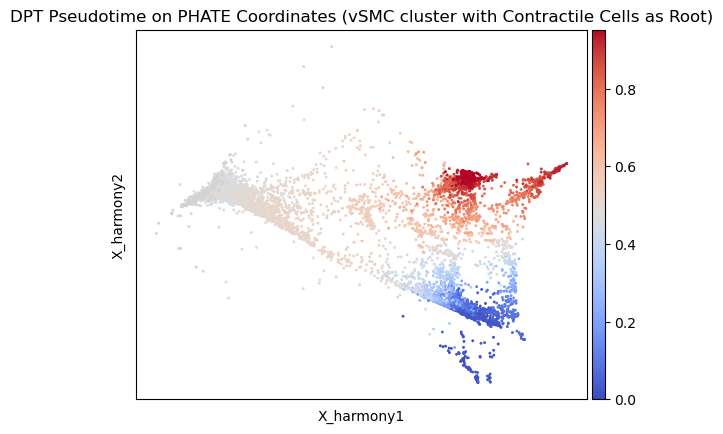

In [113]:
# Step 1: Clear any existing root cell index
#if 'iroot' in adata_SMCs.uns:
#    del adata_SMCs.uns['iroot']
    
#sc.pp.neighbors(adata_SMCs, n_neighbors=30, use_rep='X_harmony')

# Step 2: Compute Diffusion Maps
#sc.tl.diffmap(adata_SMCs)

# Step 3: Identify and Set Root Cell from Contractile Area
contractile_cells = adata_SMCs.obs['VSMC_contractile_2'] > 0.9  # Define your threshold here
contractile_indices = adata_SMCs[contractile_cells].obs.index
root_cell_index = adata_SMCs.obs.index.get_loc(contractile_indices[0])
adata_SMCs.uns['iroot'] = root_cell_index

# Step 4: Compute DPT
sc.tl.dpt(adata_SMCs)

# Step 5: Run PHATE
#phate_operator = phate.PHATE()
#adata_SMCs.obsm['X_harmony'] = phate_operator.fit_transform(adata_SMCs.X)

#Use PHATE from Above

# Step 6: Plot DPT on PHATE Coordinates
plt.figure(figsize=(10, 8))
sc.pl.embedding(adata_SMCs, basis='X_harmony', color='dpt_pseudotime', cmap='coolwarm', vmax='p95', show=False)
plt.title("DPT Pseudotime on PHATE Coordinates (vSMC cluster with Contractile Cells as Root)")
plt.show()

In [77]:
#Plot of subtype-vSMCs

In [107]:
import numpy as np
import pandas as pd

# List of gene score columns and their corresponding classifications
score_columns = {
    'VSMC_contractile_2': 'contractile',
    'VSMC_mesenchymal_2': 'mesenchymal',
    'VSMC_fibroblast_2': 'fibroblast',
    'VSMC_macrophage_2': 'macrophage',
    'VSMC_osteogenic_2': 'osteogenic',
    'VSMC_adipocyte_2': 'adipocyte'
}

# Compute 90th percentile thresholds for each gene score column
percentiles = {name: np.percentile(adata_SMCs.obs[col],90) for col, name in score_columns.items()}

# Create a new column in the AnnData object
adata_SMCs.obs['VSMC_subclassification'] = 'indeterminate'

# Assign classifications based on 90th percentile thresholds
for col, subclass in score_columns.items():
    print(col)
    print(subclass)
    # Find cells where the score is above the 90th percentile threshold for this subclass
    high_scores = adata_SMCs.obs[col] > percentiles[subclass]
    
    # Update subclassification to this subclass where appropriate
    adata_SMCs.obs.loc[high_scores, 'VSMC_subclassification'] = subclass


VSMC_contractile_2
contractile
VSMC_mesenchymal_2
mesenchymal
VSMC_fibroblast_2
fibroblast
VSMC_macrophage_2
macrophage
VSMC_osteogenic_2
osteogenic
VSMC_adipocyte_2
adipocyte


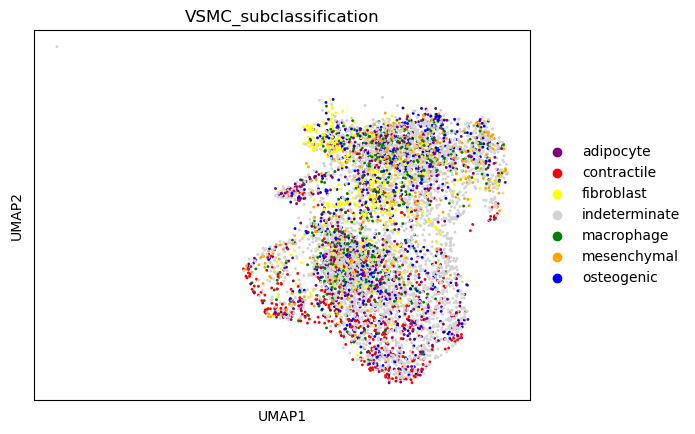

In [108]:
sc.pl.umap(adata_SMCs, color='VSMC_subclassification', palette=['purple', 'red','yellow','#d3d3d3','green','orange','blue',])

In [109]:
# Get the total number of cells
total_cells = adata_SMCs.shape[0]

# Get the counts for each unique value in the VSMC_subclassification column
value_counts = adata_SMCs.obs['VSMC_subclassification'].value_counts()

# Print the number and percentage for each unique value
for value, count in value_counts.items():
    percentage = (count / total_cells) * 100
    print(f"VSMC_subclassification: {value}, Count: {count}, Percentage: {percentage:.2f}%")


VSMC_subclassification: indeterminate, Count: 3723, Percentage: 53.06%
VSMC_subclassification: adipocyte, Count: 702, Percentage: 10.01%
VSMC_subclassification: osteogenic, Count: 617, Percentage: 8.79%
VSMC_subclassification: macrophage, Count: 555, Percentage: 7.91%
VSMC_subclassification: fibroblast, Count: 509, Percentage: 7.25%
VSMC_subclassification: mesenchymal, Count: 471, Percentage: 6.71%
VSMC_subclassification: contractile, Count: 439, Percentage: 6.26%


In [110]:
#Adata object .h5ad after all code 7_29_2024

In [111]:
# Save the AnnData object to a file
adata_no_doub.write('/gpfs/gibbs/project/chung/shared/notebooks/DVD_aorta_analysis/adata_no_doub_post_ALL_code_7_29_2024.h5ad')